In [2]:
import os
import scanpy as sc
import anndata as ad
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
plt.rcParams['figure.dpi'] = 600
sc.logging.print_versions()
sc.settings.verbosity = 3
os.chdir('./../')

TypeError: version() missing 1 required positional argument: 'distribution_name'

In [4]:
metadata = pd.read_csv('./../CPI/data/crosspecies/metadata.txt', sep='\t')
metadata['name'] = [x.lower() for x in metadata['name']]
metadata

,name,raw file 1,raw file 2,raw file 3,species,individual,condition,run
0,mouse1_unst,24754_6_S1_L001_I1_001.fastq.gz,24754_6_S1_L001_R1_001.fastq.gz,24754_6_S1_L001_R2_001.fastq.gz,mouse,1,unst,24754_6
1,mouse1_lps2,24754_7_S1_L001_I1_001.fastq.gz,24754_7_S1_L001_R1_001.fastq.gz,24754_7_S1_L001_R2_001.fastq.gz,mouse,1,LPS2,24754_7
2,mouse1_lps4,24728_6_S1_L001_I1_001.fastq.gz,24728_6_S1_L001_R1_001.fastq.gz,24728_6_S1_L001_R2_001.fastq.gz,mouse,1,LPS4,24728_6
3,mouse1_lps6,24754_8_S1_L001_I1_001.fastq.gz,24754_8_S1_L001_R1_001.fastq.gz,24754_8_S1_L001_R2_001.fastq.gz,mouse,1,LPS6,24754_8
4,mouse1_pic2,24728_7_S1_L001_I1_001.fastq.gz,24728_7_S1_L001_R1_001.fastq.gz,24728_7_S1_L001_R2_001.fastq.gz,mouse,1,PIC2,24728_7
...,...,...,...,...,...,...,...,...
63,pig3_lps2,25300_6_S1_L001_I1_001.fastq.gz,25300_6_S1_L001_R1_001.fastq.gz,25300_6_S1_L001_R2_001.fastq.gz,pig,3,LPS2,25300_6
64,pig3_lps4,25300_7_S1_L001_I1_001.fastq.gz,25300_7_S1_L001_R1_001.fastq.gz,25300_7_S1_L001_R2_001.fastq.gz,pig,3,LPS4,25300_7
65,pig3_lps6,25300_8_S1_L001_I1_001.fastq.gz,25300_8_S1_L001_R1_001.fastq.gz,25300_8_S1_L001_R2_001.fastq.gz,pig,3,LPS6,25300_8
66,pig4_unst,25336_7_S1_L001_I1_001.fastq.gz,25336_7_S1_L001_R1_001.fastq.gz,25336_7_S1_L001_R2_001.fastq.gz,pig,4,unst,25336_7


In [5]:
metadata.name.unique()

array(['mouse1_unst', 'mouse1_lps2', 'mouse1_lps4', 'mouse1_lps6',
       'mouse1_pic2', 'mouse1_pic4', 'mouse2_unst', 'mouse2_lps2',
       'mouse2_lps4', 'mouse2_lps6', 'mouse2_pic2', 'mouse2_pic4',
       'mouse2_pic6', 'mouse2_pic6a', 'mouse3_unst', 'mouse3_lps2',
       'mouse3_lps4', 'mouse3_lps6', 'mouse3_pic2', 'mouse3_pic4',
       'mouse3_pic6', 'rat1_unst', 'rat1_lps2', 'rat1_lps4', 'rat1_lps6',
       'rat1_pic2', 'rat1_pic4', 'rat1_pic6', 'rat2_unst', 'rat2_lps2',
       'rat2_lps4', 'rat2_lps6', 'rat2_pic2', 'rat2_pic4', 'rat2_pic6',
       'rat3_unst', 'rat3_lps2', 'rat3_lps4', 'rat3_lps6', 'rat3_pic2',
       'rat3_pic4', 'rat3_pic6', 'rabbit1_unst', 'rabbit1_lps2',
       'rabbit1_lps4', 'rabbit1_lps6', 'rabbit2_unst', 'rabbit2_lps2',
       'rabbit2_lps4', 'rabbit2_lps6', 'rabbit3_unst', 'rabbit3_lps2',
       'rabbit3_lps4', 'rabbit3_lps6', 'pig1_unst', 'pig1_lps2',
       'pig1_lps4', 'pig1_lps6', 'pig2_unst', 'pig2_lps2', 'pig2_lps4',
       'pig2_lps6', 'pig3_unst

In [6]:
genes = pd.read_csv('./../CPI/data/crosspecies/genes.csv', index_col=[0])
genes = genes.rename(columns={
    'mice': 'mouse',
    'rnorvegicus_homolog_ensembl_gene': 'rat',
    'ocuniculus_homolog_ensembl_gene': 'rabbit',
    'sscrofa_homolog_ensembl_gene': 'pig',
    'external_gene_name': 'gene'
})
genes

,mouse,pig,rabbit,rat,gene
1,ENSMUSG00000000001,ENSSSCG00000006824,ENSOCUG00000005553,ENSRNOG00000019465,Gnai3
2,ENSMUSG00000000056,ENSSSCG00000017126,ENSOCUG00000024065,ENSRNOG00000036664,Narf
3,ENSMUSG00000000058,ENSSSCG00000016635,ENSOCUG00000014515,ENSRNOG00000057713,Cav2
4,ENSMUSG00000000078,ENSSSCG00000028828,ENSOCUG00000002470,ENSRNOG00000016885,Klf6
5,ENSMUSG00000000085,ENSSSCG00000003971,ENSOCUG00000004703,ENSRNOG00000032183,Scmh1
...,...,...,...,...,...
6615,ENSMUSG00000101523,ENSSSCG00000007203,ENSOCUG00000014722,ENSRNOG00000005276,Gm10031
6616,ENSMUSG00000102976,ENSSSCG00000028035,ENSOCUG00000000251,ENSRNOG00000053210,Zc3h11a
6617,ENSMUSG00000103711,ENSSSCG00000006370,ENSOCUG00000022892,ENSRNOG00000047123,Tstd1
6618,ENSMUSG00000107169,ENSSSCG00000022316,ENSOCUG00000006118,ENSRNOG00000052204,Gm43796


In [7]:
base_dir = './../CPI/data/crosspecies/filtered/'
de_results_louvain = []
data = []
for subdir, dirs, files in os.walk(base_dir):
    for file in files:
        if 'pic' not in file:
            print(file)
            split_filename = file.split('_')
            mouse_name = split_filename[0] + '_' +split_filename[1]
            mouse_name = mouse_name.lower()
            adata_loop = sc.read_text(base_dir + file).transpose()
            name =  metadata.loc[metadata['name']==mouse_name]['name'].values[0]
            condition = metadata.loc[metadata['name']==mouse_name]['condition'].values[0]
            species = metadata.loc[metadata['name']==mouse_name]['species'].values[0]
            adata_loop.obs['name'] = name
            adata_loop.obs['condition'] = condition
            adata_loop.obs['species'] = species
            adata_loop = adata_loop[:, np.in1d(adata_loop.var_names, genes[species])]
            
            tmp_genes = genes.set_index(species)
            adata_loop.var['gene'] = tmp_genes.loc[adata_loop.var_names]['gene']
            adata_loop.var = adata_loop.var.set_index('gene')
            data.append(adata_loop)

rat2_lps4_filtered_by_cell_cluster0.txt


/home/icb/carlo.dedonno/anaconda3/envs/sc/lib/python3.7/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
Trying to set attribute `.var` of view, copying.


mouse2_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse2_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig1_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig1_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat2_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat2_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit2_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig1_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse2_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse3_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit3_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit3_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat3_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit3_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat1_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig2_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse1_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig2_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit1_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat1_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse1_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat1_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig2_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse1_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig3_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit2_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat2_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig1_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit2_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse2_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit2_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit3_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse3_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat3_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat3_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse3_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse3_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat3_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit1_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


mouse1_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rat1_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit1_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


rabbit1_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig2_lps6_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig3_lps4_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig3_unst_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


pig3_lps2_filtered_by_cell_cluster0.txt


Trying to set attribute `.var` of view, copying.


In [8]:
adata = data[0].concatenate(data[1:])

In [9]:
adata

AnnData object with n_obs × n_vars = 119792 × 6619
    obs: 'name', 'condition', 'species', 'batch'

In [10]:
adata.write('./datasets/cross_species_raw.h5ad')

/home/icb/carlo.dedonno/anaconda3/envs/sc/lib/python3.7/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'name' as categorical
... storing 'condition' as categorical
... storing 'species' as categorical


# Basic

In [2]:
adata = sc.read('./datasets/cross_species_raw.h5ad')

In [3]:
adata.obs['species'].value_counts()

rabbit    34528
mouse     33085
rat       28710
pig       23469
Name: species, dtype: int64

In [4]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)

mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
ribo_gene_mask = [(gene.startswith('Rps') or gene.startswith('Rpl')) for gene in adata.var_names]
hbb_gene_mask = [gene.startswith('Hbb') for gene in adata.var_names]
adata.obs['hbb_frac'] = np.asarray(adata.X[:, np.flatnonzero(hbb_gene_mask)].sum(1)).flatten()/adata.obs['n_counts']
adata.obs['ribo_frac'] = np.asarray(adata.X[:, np.flatnonzero(ribo_gene_mask)].sum(1)).flatten()/adata.obs['n_counts']
adata.obs['mt_frac'] = np.asarray(adata.X[:, np.flatnonzero(mt_gene_mask)].sum(1)).flatten()/adata.obs['n_counts']

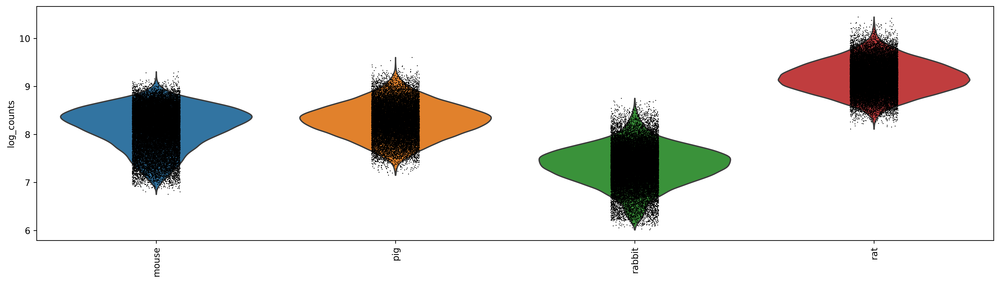

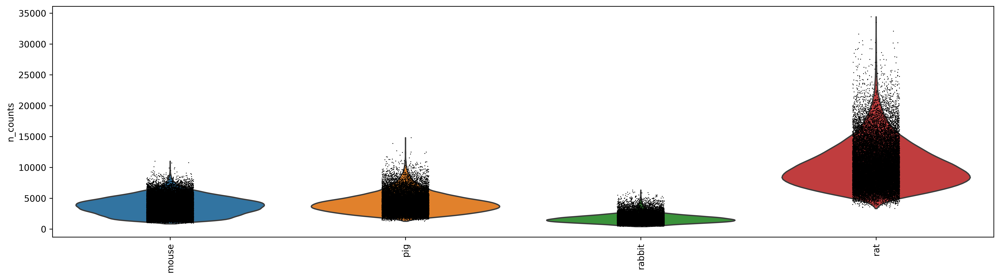

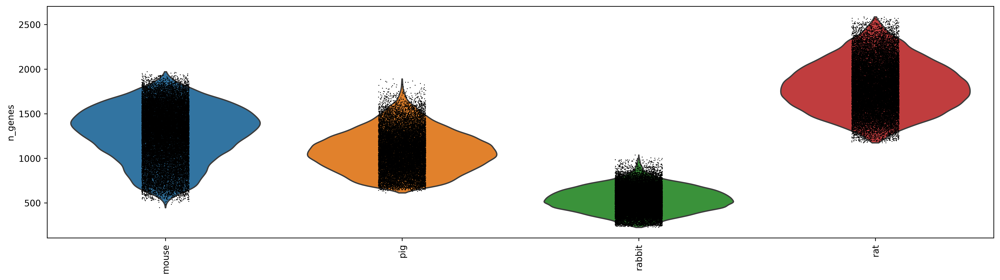

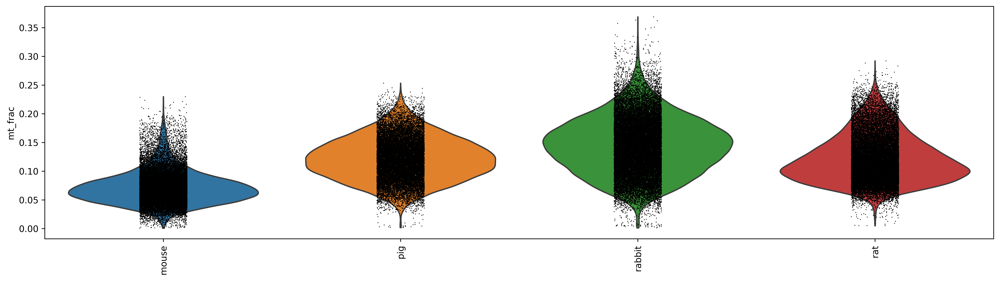

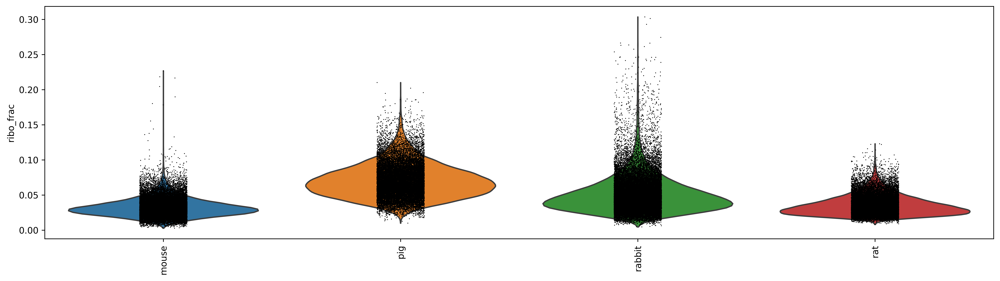

In [5]:
plt.rcParams['figure.figsize']= (15,5)
sc.pl.violin(adata, ['log_counts'], groupby='species', size=1, log=False,rotation=90)
sc.pl.violin(adata, ['n_counts'], groupby='species', size=1, log=False,rotation=90)
sc.pl.violin(adata, ['n_genes'], groupby='species', size=1, log=False,rotation=90)
sc.pl.violin(adata, ['mt_frac'], groupby='species', size=1, log=False,rotation=90)
sc.pl.violin(adata, ['ribo_frac'], groupby='species', size=1, log=False,rotation=90)

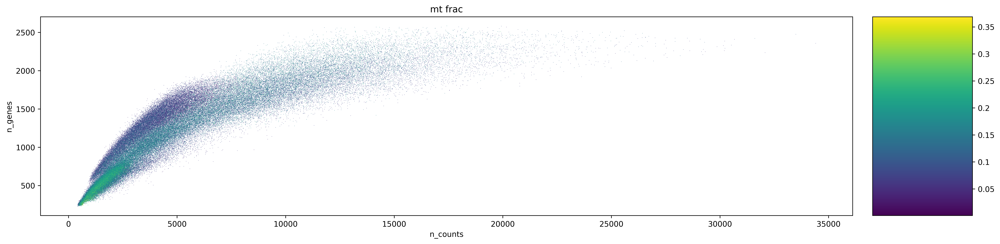

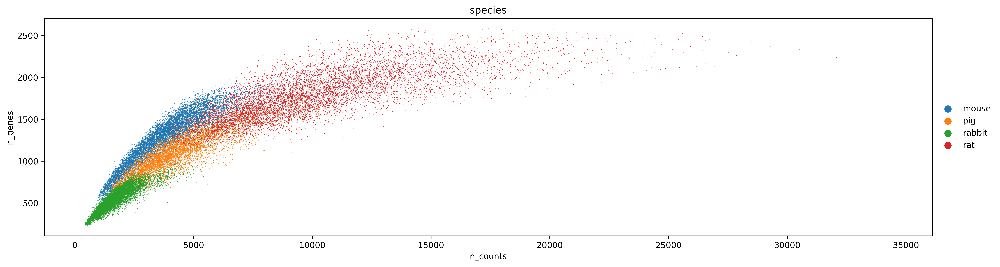

In [6]:
#Data quality summary plots
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes', color='mt_frac')
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes', color='species')

/home/icb/carlo.dedonno/anaconda3/envs/cpi/lib/python3.8/site-packages/seaborn/distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
/home/icb/carlo.dedonno/anaconda3/envs/cpi/lib/python3.8/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


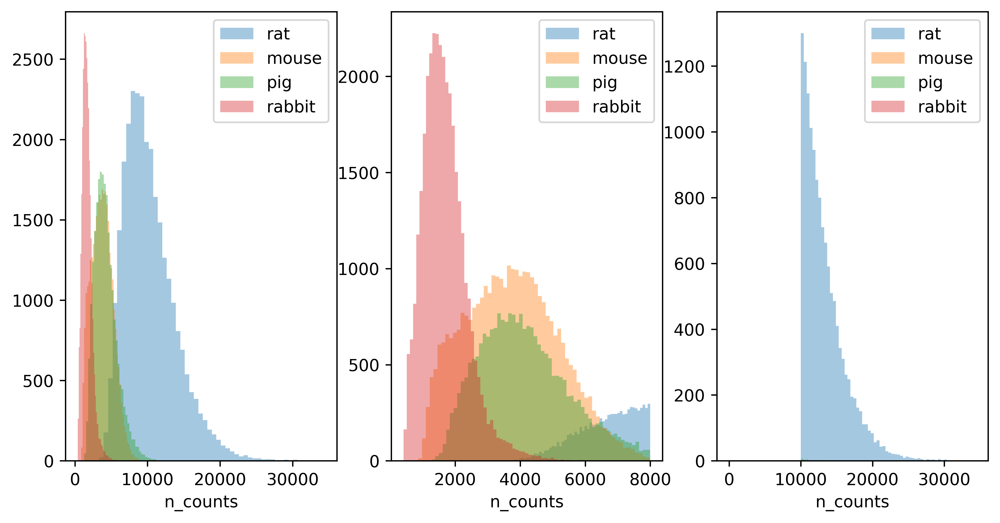

In [7]:
#Thresholding decision: counts
fig, ax = plt.subplots(1, 3, figsize=(10, 5))
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='rat'], kde=False, ax=ax[0])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='mouse'], kde=False, ax=ax[0])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='pig'], kde=False, ax=ax[0])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='rabbit'], kde=False, ax=ax[0])
ax[0].legend(['rat', 'mouse', 'pig', 'rabbit'])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='rat']\
                  [adata.obs['n_counts']<8000], kde=False, bins=60, ax=ax[1])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='mouse']\
                  [adata.obs['n_counts']<8000], kde=False, bins=60, ax=ax[1])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='pig']\
                  [adata.obs['n_counts']<8000], kde=False, bins=60, ax=ax[1])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='rabbit']\
                  [adata.obs['n_counts']<8000], kde=False, bins=60, ax=ax[1])
ax[1].legend(['rat', 'mouse', 'pig', 'rabbit'])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='rat']\
                  [adata.obs['n_counts']>10000], kde=False, bins=60, ax=ax[2])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='mouse']\
                  [adata.obs['n_counts']>10000], kde=False, bins=60, ax=ax[2])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='pig']\
                  [adata.obs['n_counts']>10000], kde=False, bins=60, ax=ax[2])
sns.distplot(adata.obs['n_counts'][adata.obs['species']=='rabbit']\
                  [adata.obs['n_counts']>10000], kde=False, bins=60, ax=ax[2])
ax[2].legend(['rat', 'mouse', 'pig', 'rabbit'])


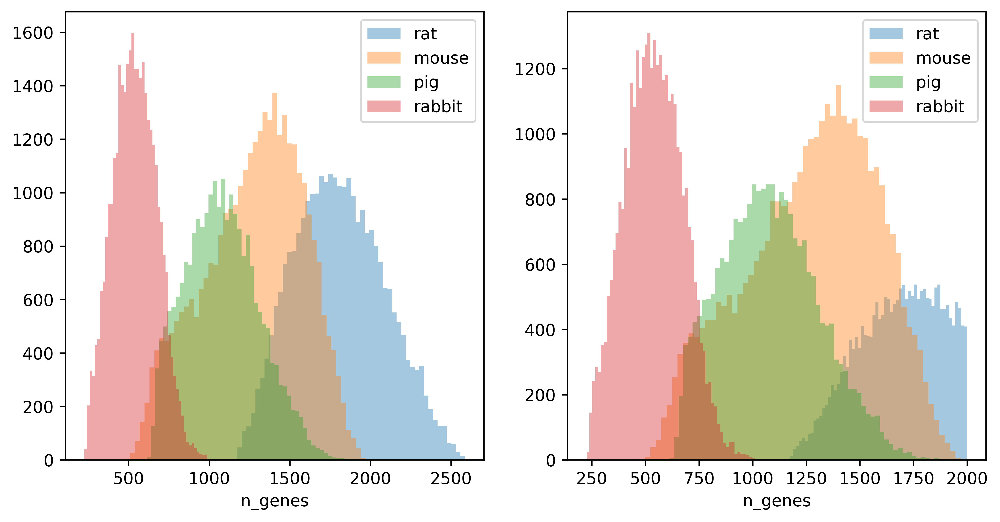

In [8]:
#Thresholding decision: counts
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='rat'], kde=False, ax=ax[0])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='mouse'], kde=False, ax=ax[0])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='pig'], kde=False, ax=ax[0])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='rabbit'], kde=False, ax=ax[0])
ax[0].legend(['rat', 'mouse', 'pig', 'rabbit'])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='rat']\
                  [adata.obs['n_genes']<2000], kde=False, bins=60, ax=ax[1])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='mouse']\
                  [adata.obs['n_genes']<2000], kde=False, bins=60, ax=ax[1])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='pig']\
                  [adata.obs['n_genes']<2000], kde=False, bins=60, ax=ax[1])
sns.distplot(adata.obs['n_genes'][adata.obs['species']=='rabbit']\
                  [adata.obs['n_genes']<2000], kde=False, bins=60, ax=ax[1])
ax[1].legend(['rat', 'mouse', 'pig', 'rabbit'])


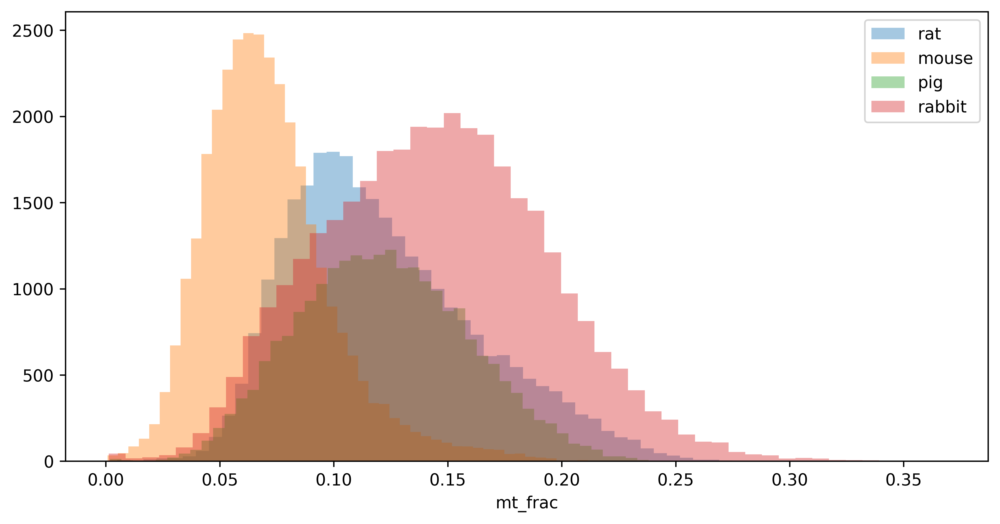

In [9]:
#Thresholding decision: counts
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.distplot(adata.obs['mt_frac'][adata.obs['species']=='rat'], kde=False, ax=ax)
sns.distplot(adata.obs['mt_frac'][adata.obs['species']=='mouse'], kde=False, ax=ax)
sns.distplot(adata.obs['mt_frac'][adata.obs['species']=='pig'], kde=False, ax=ax)
sns.distplot(adata.obs['mt_frac'][adata.obs['species']=='rabbit'], kde=False, ax=ax)
ax.legend(['rat', 'mouse', 'pig', 'rabbit'])


In [10]:
adata = adata[adata.obs.mt_frac < 0.2]

In [11]:
adata.obs.groupby('species').size()

species
mouse     33065
pig       23045
rabbit    30090
rat       27200
dtype: int64

In [12]:
adata.obs['stim'] = [x[:3] if x != 'unst' else 'unst' for x in adata.obs['condition']]
adata.obs['dosage'] = [x[-1] if x != 'unst' else '0' for x in adata.obs['condition']]

Trying to set attribute `.obs` of view, copying.


In [13]:
adata.layers['counts'] = adata.X.copy()

In [14]:
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, n_top_genes=5000, batch_key='species', subset=True)

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


... storing 'stim' as categorical
... storing 'dosage' as categorical


    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [15]:
sc.pp.pca(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:39)


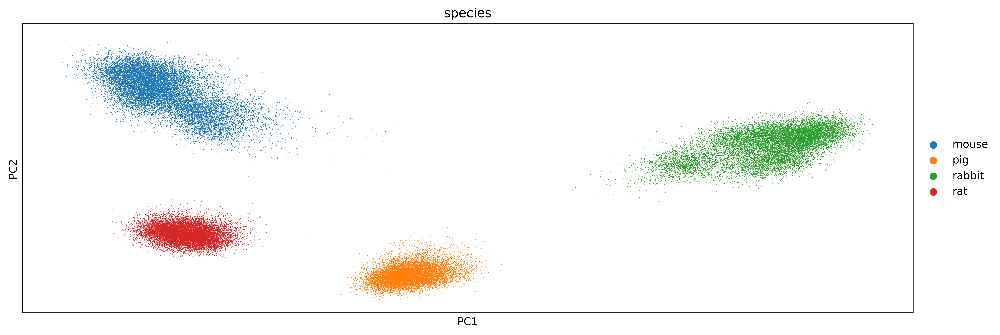

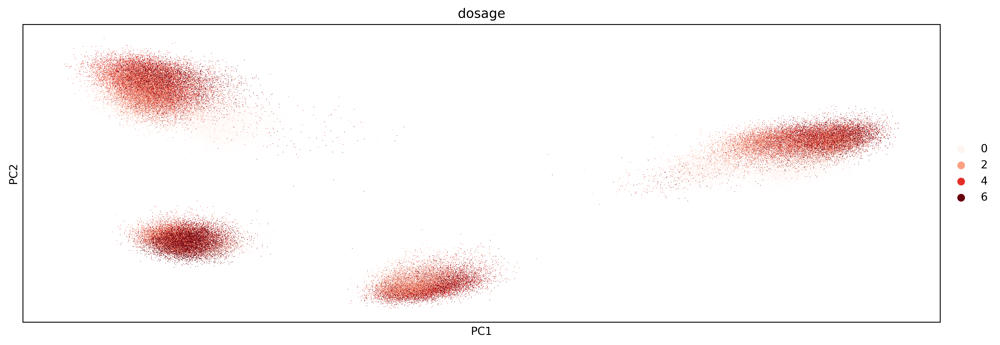

In [16]:
sc.pl.pca_scatter(adata, color=['species'])
sc.pl.pca_scatter(adata, color=['dosage'], palette='Reds')

In [17]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:50)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:05)


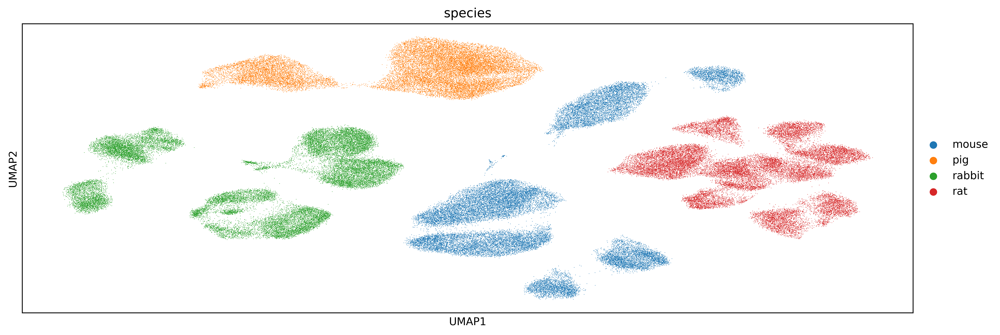

In [18]:
sc.pl.umap(adata, color='species')

# Processing for the model

In [40]:
adata.obs['dose_val'] = adata.obs.dosage.astype(float) / np.max(adata.obs.dosage.astype(float))
adata.obs['dose_val'][adata.obs['stim'].str.contains('unst')] = 1.0

adata.obs['cell_type'] = adata.obs.species.copy()
adata.obs['drug_dose_name'] = adata.obs.stim.astype(str) + '_' + adata.obs.dose_val.astype(str)
adata.obs['cov_drug_dose_name'] = adata.obs.species.astype(str) + '_' + adata.obs.drug_dose_name.astype(str)
adata.obs['condition'] = adata.obs.stim.copy()
adata.obs['control'] = [1 if x == 'unst_1.0' else 0 for x in adata.obs.drug_dose_name.values]

<ipython-input-40-3e0d3618f549>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs['dose_val'][adata.obs['stim'].str.contains('unst')] = 1.0


In [43]:
from cpa.helper import rank_genes_groups_by_cov

In [44]:
rank_genes_groups_by_cov(adata, groupby='cov_drug_dose_name', covariate='species', control_group='unst_1.0')

rat
ranking genes


/home/icb/carlo.dedonno/anaconda3/envs/cpi/lib/python3.8/site-packages/anndata/_core/anndata.py:1209: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
mouse
ranking genes


Trying to set attribute `.obs` of view, copying.
... storing 'drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)
pig
ranking genes


Trying to set attribute `.obs` of view, copying.
... storing 'drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
rabbit
ranking genes


Trying to set attribute `.obs` of view, copying.
... storing 'drug_dose_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'cov_drug_dose_name' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


# Splits

In [72]:
adata.obs['split'] = 'nan'
adata.obs['split'].loc[adata.obs['cov_drug_dose_name']=='rat_LPS_1.0'] = 'ood'

In [75]:
from sklearn.model_selection import train_test_split

In [76]:
adata_idx = adata.obs_names[adata.obs.split!='ood']

In [78]:
adata_idx_train, adata_idx_test = train_test_split(adata_idx, test_size=0.3, random_state=42)

In [80]:
adata.obs['split'].loc[adata_idx_train] = 'train'
adata.obs['split'].loc[adata_idx_test] = 'test'

In [81]:
adata.obs.groupby('split').size()

split
ood       7827
test     31672
train    73901
dtype: int64

# Cleanup

In [82]:
del adata.raw

In [87]:
adata.write('./datasets/cross_species_new.h5ad')

... storing 'drug_dose_name' as categorical
... storing 'cov_drug_dose_name' as categorical
... storing 'split' as categorical


# Add new splits

In [6]:
adata = sc.read("../datasets/cross_species_new.h5ad")

In [27]:
basic_split = adata.obs['split'].values

In [38]:
import numpy as np
def print_split(split_name):
    for d in np.unique(adata.obs[split_name].values):
        print(d, len(adata.obs[split_name].values[adata.obs[split_name].values == d]))
print_split('split')

ood 7827
test 31672
train 73901


In [39]:
np.unique(adata.obs['cov_drug_dose_name'])

array(['mouse_LPS_0.3333333333333333', 'mouse_LPS_0.6666666666666666',
       'mouse_LPS_1.0', 'mouse_unst_1.0', 'pig_LPS_0.3333333333333333',
       'pig_LPS_0.6666666666666666', 'pig_LPS_1.0', 'pig_unst_1.0',
       'rabbit_LPS_0.3333333333333333', 'rabbit_LPS_0.6666666666666666',
       'rabbit_LPS_1.0', 'rabbit_unst_1.0', 'rat_LPS_0.3333333333333333',
       'rat_LPS_0.6666666666666666', 'rat_LPS_1.0', 'rat_unst_1.0'],
      dtype=object)

In [40]:
new_split = 'split1'
adata.obs[new_split] = basic_split.copy()
adata.obs[new_split].loc[adata.obs['cov_drug_dose_name'].isin(['rat_LPS_1.0', 'rat_LPS_0.3333333333333333'])] = 'ood'
print_split(new_split)

ood 14852
test 29534
train 69014


In [41]:
new_split = 'split2'
adata.obs[new_split] = basic_split.copy()
adata.obs[new_split].loc[adata.obs['cov_drug_dose_name'].isin(['rat_LPS_1.0', 'rat_LPS_0.3333333333333333', 'rat_LPS_0.6666666666666666'])] = 'ood'
print_split(new_split)

ood 20607
test 27819
train 64974


In [45]:
new_split = 'split3'
adata.obs[new_split] = basic_split.copy()
adata.obs[new_split].loc[adata.obs['cov_drug_dose_name'].isin(['rat_LPS_1.0', 'rat_LPS_0.6666666666666666'])] = 'ood'
print_split(new_split)

ood 13582
test 29957
train 69861


In [44]:
new_split = 'split4'
adata.obs[new_split] = basic_split.copy()
adata.obs[new_split].loc[adata.obs['cov_drug_dose_name'].isin(['rat_LPS_1.0', 'mouse_LPS_1.0'])] = 'ood'
print_split(new_split)

ood 13107
test 30138
train 70155


In [ ]:
adata.write('../datasets/cross_species_new.h5ad')